In [ ]:
import numpy as np
import os
import glob 
import time 
import pandas as pd
import shutil
import re
import mdtraj as md
import MDAnalysis as mda
import pickle
import pickle as p 
import csv
import sys
import subprocess
import xml.etree.ElementTree as ET
import requests
import concurrent.futures
import multiprocessing
import nglview as nv
import h5py
import matplotlib as mpl
import matplotlib.patheffects as path_effects
import matplotlib.patches as patches
import html
import biobox as bb
import tempfile
import matplotlib.pyplot as plt
import molearn
import torch
import glob as glob
import MDAnalysis.analysis.rms as rms
import seaborn as sns
import pickle
import networkx as nx
sys.path.insert(0, os.path.join(os.path.abspath(os.pardir),'src'))

from Bio import PDB
from tqdm import tqdm
from time import time as t
from urllib.request import urlretrieve as download
from Bio.Blast import NCBIWWW, NCBIXML
from Bio.Blast.Applications import NcbipsiblastCommandline
from collections import defaultdict
from Bio.PDB import PPBuilder
from Bio.SeqUtils import seq1
from modeller import *
from modeller.automodel import *
from Bio.PDB import PDBParser
from MDAnalysis.analysis import align
from mpi4py import MPI
from glob import glob
from pprint import pprint as pp
from matplotlib import pyplot as plt
from sklearn.decomposition import PCA
from glob import glob as g
from tqdm.notebook import tqdm
from collections import Counter
from matplotlib.ticker import FuncFormatter
from collections import defaultdict
from pymol import cmd
from scipy.interpolate import interp1d
from mpl_toolkits import mplot3d
from scipy import stats
from sklearn.cluster import AgglomerativeClustering, SpectralClustering
from matplotlib.colors import BoundaryNorm
from numpy.linalg import norm
from molearn.data import PDBData
from molearn.trainers import Trainer
from molearn.models.small_foldingnet import Small_AutoEncoder
from molearn.analysis.analyser import MolearnAnalysis
from copy import deepcopy
from molearn.analysis import MolearnGUI
from scipy.ndimage import rotate
from numpy.linalg import inv
from sklearn.cluster import HDBSCAN
from sklearn.metrics import silhouette_score
from itertools import combinations
from urllib.request import urlretrieve
from urllib.error import URLError
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, ConfusionMatrixDisplay
from sklearn.inspection import permutation_importance
from sklearn.tree import export_graphviz
from sklearn import tree
from scipy.stats import pearsonr


/root/miniconda3/envs/braf-work/lib/python3.10/site-packages/Bio/Application/__init__.py:39: BiopythonDeprecationWarning: The Bio.Application modules and modules relying on it have been deprecated.

Due to the on going maintenance burden of keeping command line application
wrappers up to date, we have decided to deprecate and eventually remove these
modules.

We instead now recommend building your command line and invoking it directly
with the subprocess module.
  warnings.warn(


/root/miniconda3/envs/braf-work/lib/python3.10/site-packages/molearn/trainers/sinkhorn_trainer.py:13: UserWarning: No module named 'geomloss'. Will not be able to use sinkhorn because geomloss is not installed.
  warnings.warn(f'{e}. Will not be able to use sinkhorn because geomloss is not installed.')
/root/miniconda3/envs/braf-work/lib/python3.10/site-packages/molearn/scoring/__init__.py:26: UserWarning: No module named 'iotbx'. Will not be able to calculate Ramachandran score.
  warnings.warn(f"{e}. Will not be able to calculate Ramachandran score.")


Running MUSTANG Algorithm

Creating a folder for unreconstructed structures to be used in MUSTANG alignment.

In [ ]:
def create_nonreconstructed_folder():
    unaligned_dir = "Results/activation_segments/unaligned"
    reconstructed_dir = "Results/activation_segments/reconstructedModeller"
    target_dir = "Results/activation_segments/nonReconstructed4Mustang"
    
    if not os.path.exists(target_dir):
        os.makedirs(target_dir)
        print(f"Created directory: {target_dir}")
    
    unaligned_files = [f for f in os.listdir(unaligned_dir) if f.endswith('.pdb')]
    reconstructed_files = [f for f in os.listdir(reconstructed_dir) if f.endswith('.pdb')]
    
    # Extract the first 6 characters of each reconstructed filename to identify corresponding entries
    reconstructed_prefixes = {f[:6] for f in reconstructed_files}
    
    copied_count = 0
    skipped_count = 0
    
    for unaligned_file in unaligned_files:
        file_prefix = unaligned_file[:6]
        
        if file_prefix in reconstructed_prefixes:
            source_path = os.path.join(unaligned_dir, unaligned_file)
            target_path = os.path.join(target_dir, unaligned_file)
            
            # Copy unaligned file to the target directory if it was reconstructed
            shutil.copy(source_path, target_path)
            copied_count += 1
        else:
            skipped_count += 1
    
    print(f"Copied {copied_count} files from '{unaligned_dir}' to '{target_dir}'")
    print(f"Skipped {skipped_count} files that don't have matching entries in '{reconstructed_dir}'")
    print(f"These files have matching entries in '{reconstructed_dir}' based on the first 6 characters")

if __name__ == '__main__':
    create_nonreconstructed_folder()
    print("Processing complete!")

Created directory: Results/activation_segments/nonReconstructed4Mustang
Copied 3845 files from 'Results/activation_segments/unaligned' to 'Results/activation_segments/nonReconstructed4Mustang'
Skipped 8467 files that don't have matching entries in 'Results/activation_segments/reconstructedModeller'
These files have matching entries in 'Results/activation_segments/reconstructedModeller' based on the first 6 characters
Processing complete!


Select the structures whose have DFG and APE

In [ ]:
"""
Filter PDB files from a directory that contain the specific structural motifs DFG and APE, ensuring that they appear in a valid order (with DFG preceding APE and a reasonable distance between them). Qualified structures are copied to a new directory for further use, and all processing details are recorded in a log file for review and traceability.
"""
import os
import shutil
from glob import glob
from Bio.PDB import PDBParser, PPBuilder

pdb_dir = "Results/activation_segments/nonReconstructed4Mustang/"
filtered_dir = "Results/activation_segments/nonReconstructed4Mustang_filtered/"
log_dir = "Results/activation_segments/nonReconstructed4Mustang_filtered/"
log_file = os.path.join(log_dir, "motif_verification_log.txt")

os.makedirs(filtered_dir, exist_ok=True)
os.makedirs(log_dir, exist_ok=True)

print(f"Created/verified directories:\n- {filtered_dir}\n- {log_dir}")

with open(log_file, 'w') as f:
    f.write("Motif Verification Log\n")
    f.write("=====================\n\n")

def log_message(message):
    """Write message to log file and print to console."""
    print(message)
    try:
        with open(log_file, 'a') as f:
            f.write(message + "\n")
    except Exception as e:
        print(f"WARNING: Could not write to log file: {e}")

def extract_atom_sequence(pdb_file):
    parser = PDBParser(QUIET=True)
    try:
        structure = parser.get_structure('PDB', pdb_file)
        
        for model in structure:
            for chain in model:
                ppb = PPBuilder()
                sequence = ''
                for pp in ppb.build_peptides(chain):
                    sequence += pp.get_sequence()
                return str(sequence)
    except Exception as e:
        log_message(f"Error extracting sequence from {pdb_file}: {e}")
    return None

def find_motif_indices(seq, motif):
    index = seq.find(motif)
    if index == -1:
        return None
    return index, index + len(motif)

def find_dfg_motif_index(seq):
    for motif in ["DFG"]:
        result = find_motif_indices(seq, motif)
        if result is not None:
            return result, motif
    return None, None

def find_ape_motif_index(seq):
    for motif in ["APE"]:
        result = find_motif_indices(seq, motif)
        if result is not None:
            return result, motif
    return None, None

def filter_structures_by_motifs():
    # Check if input directory exists
    if not os.path.exists(pdb_dir):
        log_message(f"ERROR: Input directory does not exist: {pdb_dir}")
        return False
        
    fps = glob(pdb_dir + "/*.pdb")
    log_message(f"Found {len(fps)} PDB files to check.")
    
    valid_count = 0
    invalid_count = 0
    
    for fp in fps:
        pdb_code = os.path.basename(fp).split('.')[0]
        log_message(f"\nChecking {pdb_code}...")
        
        seq = extract_atom_sequence(fp)
        if seq is None:
            log_message(f"  - Could not extract sequence. Skipping.")
            invalid_count += 1
            continue
        
        dfg_result, dfg_motif = find_dfg_motif_index(seq)
        
        ape_result, ape_motif = find_ape_motif_index(seq)

        # Only keep files where both DFG and APE motifs are found
        if dfg_result is not None and ape_result is not None:
            dfg_start, dfg_end = dfg_result
            ape_start, ape_end = ape_result
            
            # Motifs must appear in correct order and be at least 5 residues apart
            if dfg_start < ape_start and (ape_start - dfg_end) >= 5:
                log_message(f"  - Found {dfg_motif} at position {dfg_start} and {ape_motif} at position {ape_start}")
                
                # Copy the valid PDB file to the filtered directory
                dest_path = os.path.join(filtered_dir, os.path.basename(fp))
                shutil.copy(fp, dest_path)
                log_message(f"  - Copying to {dest_path}")
                valid_count += 1
            else:
                log_message(f"  - Found motifs but in wrong order or too close: {dfg_motif}({dfg_start}) and {ape_motif}({ape_start})")
                invalid_count += 1
        else:
            # Log which motif was missing
            if dfg_result is None:
                log_message(f"  - DFG motif not found")
            if ape_result is None:
                log_message(f"  - APE motif not found")
            invalid_count += 1
    
    # Summary of results
    log_message(f"\nFiltering complete:")
    log_message(f"  - {valid_count} structures have valid DFG and APE motifs")
    log_message(f"  - {invalid_count} structures were excluded")
    log_message(f"  - Valid structures copied to {filtered_dir}")
    
    return valid_count > 0

if __name__ == '__main__':
    log_message(f"Starting filtering process. Working directory: {os.getcwd()}")
    log_message(f"Using input directory: {pdb_dir}")
    log_message(f"Output directory: {filtered_dir}")
    
    log_message("Filtering structures based on presence of DFG and APE motifs...")
    motifs_present = filter_structures_by_motifs()
    
    if motifs_present:
        log_message("\nFiltering process complete! Filtered structures saved to:")
        log_message(filtered_dir)
    else:
        log_message("No valid structures found with both DFG and APE motifs.")

Created/verified directories:
- Results/activation_segments/nonReconstructed4Mustang_filtered/
- Results/activation_segments/nonReconstructed4Mustang_filtered/
Starting filtering process. Working directory: /mnt/d/Desktop/formal_code
Using input directory: Results/activation_segments/nonReconstructed4Mustang/
Output directory: Results/activation_segments/nonReconstructed4Mustang_filtered/
Filtering structures based on presence of DFG and APE motifs...
Found 3845 PDB files to check.

Checking 1A9U_A...
  - Found DFG at position 164 and APE at position 186
  - Copying to Results/activation_segments/nonReconstructed4Mustang_filtered/1A9U_A.pdb

Checking 1AD5_A...
  - Found DFG at position 320 and APE at position 336
  - Copying to Results/activation_segments/nonReconstructed4Mustang_filtered/1AD5_A.pdb

Checking 1AD5_B...
  - Found DFG at position 320 and APE at position 336
  - Copying to Results/activation_segments/nonReconstructed4Mustang_filtered/1AD5_B.pdb

Checking 1AGW_A...
  - Fou

Run MUSTANG and attain RMSD value

In [ ]:
"""
This script performs structural alignment using the MUSTANG tool between a given template PDB file and multiple target PDB structures. It parses the RMSD values from the alignment results, organizes all output files into dedicated folders per structure, and writes a summary of RMSD values for all successfully aligned structures. 
"""

import os
import subprocess
from glob import glob
from time import time
import re  

# Define paths for input PDBs, output results, and template structure
pdb_path = "Results/activation_segments/nonReconstructed4Mustang_filtered"
target_dir = "Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD"
template_pdb = "6UAN_chainD.pdb"
os.makedirs(target_dir, exist_ok=True)

print(f"Input directory: {pdb_path}")
print(f"Output directory: {target_dir}")
print(f"Template PDB: {template_pdb}")

# Utility to get all .pdb files from a given directory
def find_pdbs(directory):
    return glob(os.path.join(directory, "*.pdb"))

# Utility to extract file name without extension
def fname(path):
    return os.path.splitext(os.path.basename(path))[0]

# Run MUSTANG alignment between the template and input structure, and extract RMSD
def run_mustang(template_pdb, input_pdb, name=None):
    if name is None:
        name = fname(input_pdb)
    
    try:
        struct_dir = os.path.join(target_dir, name)
        os.makedirs(struct_dir, exist_ok=True)
        new_fp = os.path.join(struct_dir, name)
        structs = f"{template_pdb} {input_pdb}"
        command = f"mustang -i {structs} -o {new_fp} -F fasta -s ON -r ON"
        print(f"Running MUSTANG: {command}")
        
        result = subprocess.run(command, shell=True, capture_output=True, text=True)
        
        if result.returncode != 0:
            print(f"MUSTANG failed: {result.stderr}")
            return None, None
        
        rmsd_file = os.path.join(struct_dir, f"{name}.rms_rot")
        rmsd_value = None

        if os.path.exists(rmsd_file):
            with open(rmsd_file, "r") as f:
                lines = f.readlines()
                for line in lines:
                    if line.strip().startswith("2|"):  
                        parts = line.strip().split("|")[-1].split()
                        for part in parts:
                            try:
                                rmsd_value = float(part)
                                break
                            except ValueError:
                                continue
                        break
        else:
            print(f"Warning: RMSD file not found for {name}")

        expected_output = os.path.join(struct_dir, f"{name}.pdb")
        if not os.path.exists(expected_output):
            alt_files = glob(os.path.join(struct_dir, "*.pdb"))
            if alt_files:
                expected_output = alt_files[0]
            else:
                return None, rmsd_value

        print(f"Successfully aligned {name}, RMSD = {rmsd_value}")
        return expected_output, rmsd_value  

    except Exception as e:
        print(f"Error running MUSTANG for {name}: {e}")
        return None, None

if __name__ == '__main__':
    pdbs = find_pdbs(pdb_path)
    print(f"Found {len(pdbs)} PDB files to process")

    t1 = time()
    results = []  

    for pdb in pdbs:
        name = fname(pdb)
        _, rmsd = run_mustang(template_pdb, pdb, name=name)
        if rmsd is not None:
            results.append((name, rmsd))

    t2 = time()
    print(f"Processing complete in {round(t2 - t1, 3)} seconds")

    output_path = os.path.join(target_dir, "mustang_rmsd_summary.txt")
    with open(output_path, "w") as f:
        f.write("PDB_Name\tRMSD\n")
        for name, rmsd in results:
            f.write(f"{name}\t{rmsd:.4f}\n")

    print(f"RMSD summary saved to {output_path}")


Input directory: Results/activation_segments/nonReconstructed4Mustang_filtered
Output directory: Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD
Template PDB: 6UAN_chainD.pdb
Found 3808 PDB files to process
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered/1A9U_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD/1A9U_A/1A9U_A -F fasta -s ON -r ON
Successfully aligned 1A9U_A, RMSD = 11.9
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered/1AD5_A.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD/1AD5_A/1AD5_A -F fasta -s ON -r ON
Successfully aligned 1AD5_A, RMSD = 4.2
Running MUSTANG: mustang -i 6UAN_chainD.pdb Results/activation_segments/nonReconstructed4Mustang_filtered/1AD5_B.pdb -o Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD/1AD5_B/1AD5_B -F fasta -s ON -r ON
Successfull

In [ ]:
"""
This script extracts a specific chain (e.g., chain B) from a set of PDB files located in subdirectories. It iterates through each structure folder, loads the corresponding PDB file, isolates the target chain, and saves the result into a new output directory.
"""

import os
from Bio import PDB

def extract_chain_from_pdb(pdb_path, chain_id, output_path):
    parser = PDB.PDBParser(QUIET=True)
    structure = parser.get_structure("struct", pdb_path)

    io = PDB.PDBIO()
    # Define a custom selector to retain only the specified chain during PDB saving
    class ChainSelect(PDB.Select):
        def accept_chain(self, chain):
            return chain.id == chain_id
    
    io.set_structure(structure)
    io.save(output_path, select=ChainSelect())
    print(f"Saved chain {chain_id} to {output_path}")

input_root = "Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD"
output_root = "Results/activation_segments/Mustang_with_singlechain_withoutlier"

target_chain_id = "B"

os.makedirs(output_root, exist_ok=True)

# Traverse through all folders in the input directory to locate corresponding PDB files
for folder_name in os.listdir(input_root):
    folder_path = os.path.join(input_root, folder_name)
    if not os.path.isdir(folder_path):
        continue 

    pdb_file = os.path.join(folder_path, f"{folder_name}.pdb")
    if not os.path.isfile(pdb_file):
        print(f"PDB file not found: {pdb_file}")
        continue

    output_pdb = os.path.join(output_root, f"{folder_name}.pdb")

    try:
        extract_chain_from_pdb(pdb_file, target_chain_id, output_pdb)
    except Exception as e:
        print(f"Failed to process {pdb_file}: {e}")


Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier/1A9U_A.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier/1AD5_A.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier/1AD5_B.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier/1AGW_A.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier/1APM_E.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier/1ATP_E.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier/1B38_A.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier/1B39_A.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier/1BI7_A.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_withoutlier/1BI8_A.pdb
Saved chain B to Results/activation_segments/Mustang_with_singlechain_

In [ ]:
"""
some helpful functions
"""
alignment_dir = "Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD"

class alignment:
    def __init__(self,name,seq1,seq2):
        self.name = name
        self.seq1 = seq1
        self.seq2 = seq2
        self.aligned = self.find_aligned()

    def find_pdb(self):
        # Search through the alignment directory to locate the PDB file corresponding to this alignment
        pdb_files = []
        for root, dirs, files in os.walk(alignment_dir):
            pdb_files += [os.path.join(root, file) for file in files if file.endswith('.pdb')]
        
        pdb = [f for f in pdb_files if self.name in f]
        print(pdb)
        if len(pdb) == 1:
            return pdb[0]
        

    def find_aligned(self):
        # Build a list of aligned residue pairs (excluding gaps in seq1)
        aligned = []
        for char1, char2 in zip(self.seq1,self.seq2):
            if char1 != "-":
                aligned.append((char1,char2))
        return aligned

    def aligned_res(self):
        # Map the aligned residues to actual residue objects from the PDB file
        seq1, seq2 = self.seq1, self.seq2
        aligned = [[*item] for item in self.aligned]
        seq_length = len(aligned)
        pdb2_top = self.load_pdb()
        full_seq2 = "".join(char for char in seq2 if char != "-")
        residues = pdb2_top.top._residues
        n_res = len(residues)
        res_counter = 0
        for i in range(seq_length):
            if res_counter >= n_res:
                break
            if aligned[i][1] != "-":
                aligned[i][1] = residues[res_counter]
                res_counter += 1
            else:
                continue
        return [tuple(a) for a in aligned]

    def aligned_xyz(self):
        # For each aligned residue, extract all its atom coordinates
        xyz = self.load_pdb()._xyz[0]
        aligned = [[*item] for item in self.aligned]
        for k,(_,res) in enumerate(self.residues):
            if not isinstance(res,str):
                idxs = []
                for atom in res._atoms:
                    idxs.append(atom.index)
                res_xyz = xyz[idxs]
                aligned[k][1] = res_xyz
            else:
                continue
        return [tuple(a) for a in aligned]

    def aligned_ca_xyz(self):
        # For each aligned residue, extract only the alpha carbon (CA) coordinates
        xyz = self.load_pdb()._xyz[0]
        aligned = [[*item] for item in self.aligned]
        for k,(_,res) in enumerate(self.residues):
            if not isinstance(res,str):
                for atom in res._atoms:
                    if atom.name == "CA":
                        idxs = atom.index
                        break
                try:
                    res_xyz = xyz[idxs]
                except Exception as e:
                    print(e)
                    print("ERROR FOR:")
                    print(self.name)
                    return None
                aligned[k][1] = res_xyz
            else:
                continue
        return [tuple(a) for a in aligned]

    def load_pdb(self):
        return md.load(self.pdb_file)

    def __getitem__(self,idx):
        return (self.seq1[idx],self.seq2[idx])

    def __repr__(self):
        return self.name

    def find_match_id(self):
        # Locate the aligned residues corresponding to the activation loop
        seq1, seq2 = self.seq1, self.seq2
        full_seq2 = "".join(char for char in seq2 if char != "-")
        pp(full_seq2)
        aligned = self.aligned
        actv_low = 155
        actv_hgh = 181
        match_residues = aligned[actv_low:actv_hgh]
        seq2_Seq = [a[1] for a in match_residues if a[1] != "-"]
        begin_idx = 0

In [ ]:
# Parse an .afasta file to extract the two aligned sequences
def afasta_parse(file):
    with open(file,"r") as f:
        lines = f.readlines()

    # Extract the sequence names (without the '>' and '.pdb' suffix)
    names = [l.split(".")[0][1:] for l in lines if l[0] == ">"]
    for i in range(1,len(lines)):
        if lines[i].isspace():
            lines[i] = "BREAK"
            break
        elif lines[i][0] == ">":
            lines[i] = "BREAK" + lines[i]
            break
    lines = [l.strip() for l in lines if l[0] != ">"]
    lines = "".join(lines)
    fastas = lines.split("BREAK")
    fastas = [*filter(None,fastas)]
    return fastas[0], fastas[1]

# Load alignments from a previously saved pickle file, or create one if not found
def load_alignments(kind="mustang"):
    if kind=="mustang":
        ppath = "Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD/mustang_alignments.fasta"
        
    elif kind=="blast":
        ppath = "blast_alignments.fasta"
    if os.path.isfile(ppath):
        with open(ppath,"rb") as pickled:
            return p.load(pickled)
    else:
        make_align_pickle()
        return load_alignments()
    
# Parse alignment files and save all alignment objects into a pickle file    
def make_align_pickle(kind="mustang"):
    if kind == "mustang":

        alignments = []

        for directory_name in os.listdir(alignment_dir):
            directory_path = os.path.join(alignment_dir, directory_name)

            if os.path.isdir(directory_path):
                fasta_files = tqdm(glob(os.path.join(directory_path, "*.afasta")), desc=f"Processing {directory_name} .afasta files")
                
                for fasta_file in fasta_files:
                    name = os.path.splitext(os.path.basename(fasta_file))[0]
                    fasta_files.set_description(f"Working on {name}")

                    aligned = alignment(name, *afasta_parse(fasta_file))  
                    alignments.append(aligned)

        ppath = os.path.join(alignment_dir, "mustang_alignments.fasta")
        with open(ppath, "wb") as pickled:
            p.dump(alignments, pickled)
    
    elif kind == "blast":
        b = BLAST_results()
        alignments = []
        for k, dicti in tqdm(b.alignments.items(),total=len(b.alignments)):
            seq1 = dicti["Query"]
            seq2 = dicti["Subject"]
            alignments.append(alignment(k,seq1,seq2))
        ppath = "blast_alignments.fasta"
        with open(ppath, "wb") as pickled:
            p.dump(alignments, pickled)

In [ ]:

mpl.rcParams['figure.dpi'] = 300
mpl.rcParams.update({'font.size': 8})
kind = "mustang"
make_align_pickle(kind) 
aligned = load_alignments(kind)

with open('aligned_data.pkl', 'wb') as f:
    pickle.dump(aligned, f)
print(f"Saved {len(aligned)} aligned structures to 'aligned_data.pkl'")

In [ ]:
def braf_res():
    fp = "./6UAN_chainD.pdb"
    top = md.load(fp).top
    return [res_namer(res) for res in top.residues]


def res_namer(res):
    return f"{res.name}-{res.resSeq}"

def fname(fp):
    return fp.rsplit(".",1)[0].rsplit("/",1)[-1]

def make_seg(a):
    seq = [t for t in a.aligned if t[0] != "-"]
    return seq

In [ ]:
def count_directories(directory):
    entries = os.listdir(directory)

    directories = [entry for entry in entries if os.path.isdir(os.path.join(directory, entry))]

    return len(directories)

directory_path = 'Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD'

directory_count = count_directories(directory_path)

print(f"There are {directory_count} directories in the directory '{directory_path}'.")

There are 3808 directories in the directory 'Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD'.


In [ ]:
"""
This script filters aligned protein structures by ensuring that both the "DFG" and "APE" motifs are present in the reference sequence and properly aligned to non-gap residues in the target sequence. It performs two stages of filtering, saves the valid results for downstream use, and logs the alignment status of each structure in a CSV file for easy review.
"""
if os.path.exists('aligned_data.pkl'):
    print("Loading aligned data from file...")
    with open('aligned_data.pkl', 'rb') as f:
        aligned = pickle.load(f)
    print(f"Loaded {len(aligned)} aligned structures")
else:
    raise FileNotFoundError("aligned_data.pkl not found. Please run the alignment block first.")

count = 0
new_aligned = []
bad = []

for k, a in enumerate(aligned):
    if a.seq1.find("DFG") == -1 or a.seq1.find("APE") == -1:
        bad.append(a)
        count += 1
    else:
        new_aligned.append(a)

print(count, "/", len(aligned), " don't match.")
print(f"Continuing with {len(new_aligned)} structures")

with open('new_aligned_data.pkl', 'wb') as f:
    pickle.dump(new_aligned, f)
print(f"Saved {len(new_aligned)} filtered structures to 'new_aligned_data.pkl'")

counts = {}
counter = 0
new_aligned2 = []
aligning_segs = {}
lengths = []

for a in new_aligned:
    DFG_index = a.seq1.find("DFG")
    APE_index = a.seq1.find("APE")
    dfg = a.seq2[DFG_index]
    ape = a.seq2[APE_index]
    
    if dfg != "-" and ape != "-":
        counter += 1
        length = APE_index - DFG_index
        counts.setdefault(length, []).append((a.name, DFG_index, APE_index))
        new_aligned2.append(a)
        aligning_segs.setdefault(a.name,
                                 (a.seq2[DFG_index:DFG_index+3],
                                  a.seq2[APE_index:APE_index+3],
                                  a.seq2[DFG_index:APE_index+3]))
        lengths.append(len(a.seq2[DFG_index:APE_index+3]))

print(f"{counter} structures with an alignment to the D and A")

with open('filtered_aligned_data.pkl', 'wb') as f:
    filtered_data = {
        'new_aligned2': new_aligned2,
        'aligning_segs': aligning_segs,
        'counts': counts,
        'lengths': lengths
    }
    pickle.dump(filtered_data, f)
print(f"Saved {len(new_aligned2)} final filtered structures to 'filtered_aligned_data.pkl'")

with open('alignment_results.csv', mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(['Name', 'Seq1 Segment', 'Seq2 Segment', 'Status'])

    for a in new_aligned2:
        DFG_index = a.seq1.find("DFG")
        APE_index = a.seq1.find("APE")
        seq1_segment = a.seq1[DFG_index:APE_index+3]
        seq2_segment = a.seq2[DFG_index:APE_index+3]
        writer.writerow([a.name, seq1_segment, seq2_segment, 'Aligned'])

    for a in bad:
        writer.writerow([a.name, '', '', 'Not Aligned'])

Loading aligned data from file...
Loaded 3808 aligned structures
153 / 3808  don't match.
Continuing with 3655 structures
Saved 3655 filtered structures to 'new_aligned_data.pkl'
3593 structures with an alignment to the D and A
Saved 3593 final filtered structures to 'filtered_aligned_data.pkl'


1A9U_A [('D', '-', 0, 0), ('W', 'T', 1, 4), ('E', 'F', 2, 5), ('I', 'Y', 3, 6), ('P', 'R', 4, 7), ('D', 'P', 5, 18), ('G', 'E', 6, 19), ('Q', 'R', 7, 20), ('I', 'Y', 8, 21), ('T', 'Q', 9, 22), ('V', 'N', 10, 23), ('G', 'L', 11, 24), ('Q', 'S', 12, 25), ('R', 'P', 13, 26), ('I', 'V', 14, 27), ('G', 'G', 15, 28), ('S', 'S', 16, 29), ('G', 'G', 17, 30), ('S', 'A', 18, 31), ('F', 'Y', 19, 32), ('G', 'G', 20, 33), ('T', 'S', 21, 34), ('V', 'V', 22, 35), ('Y', 'C', 23, 36), ('K', 'A', 24, 37), ('G', 'A', 25, 38), ('K', 'F', 26, 39), ('W', 'D', 27, 40), ('H', 'G', 28, 44), ('G', 'L', 29, 45), ('D', 'R', 30, 46), ('V', 'V', 31, 47), ('A', 'A', 32, 48), ('V', 'V', 33, 49), ('K', 'K', 34, 50), ('M', 'K', 35, 51), ('L', 'L', 36, 52), ('N', 'S', 37, 53), ('V', 'R', 38, 54), ('T', '-', 39, 54), ('A', '-', 40, 54), ('P', 'Q', 41, 57), ('T', 'S', 42, 58), ('P', 'I', 43, 59), ('Q', 'I', 44, 60), ('Q', 'H', 45, 61), ('L', 'A', 46, 62), ('Q', 'K', 47, 63), ('A', 'R', 48, 64), ('F', 'T', 49, 65), ('K', '

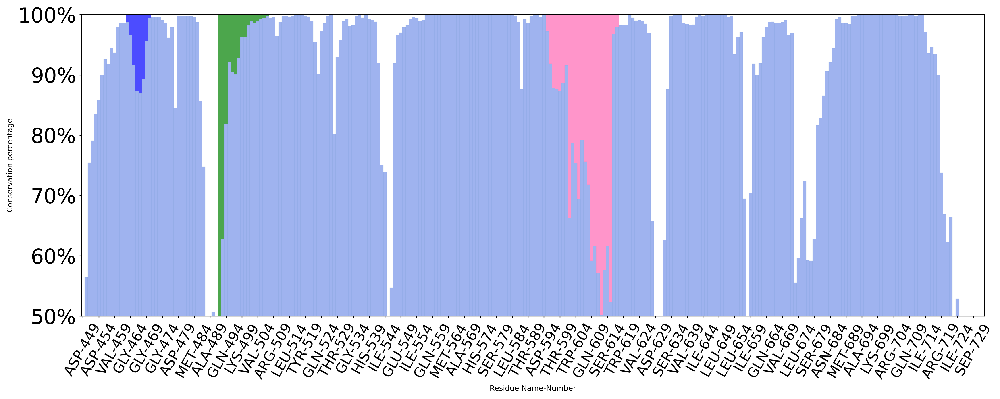

In [ ]:
#Finding highly conserved residues (=100% conservation) in the filtered alignments

filtered_aligned = new_aligned2
total_alignments = len(filtered_aligned)

# Get the number of non-gap residues in the sequence
seq1mag = len(filtered_aligned[0].seq1.replace("-", ""))  
counts = np.zeros(seq1mag)

# Write alignment index mapping to file
output_file = "alignment_segment_with_index.csv"
with open(output_file, mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow([ "PDB_Name", "Template_Res", "Target_Res", "Template_Index", "Target_Index"])

    for a in filtered_aligned:
        seq1 = a.seq1  
        seq2 = a.seq2  

        continuous_index = 0  
        num_gap_seq2 = 0      
        segment_with_index = []  

        for idx, (res1, res2) in enumerate(zip(seq1, seq2), start=1):
            if res2 == "-":
                num_gap_seq2 += 1
            if res1 != "-":
                template_index = continuous_index
                target_index = idx - num_gap_seq2

                segment_with_index.append((res1, res2, template_index, target_index))

                if res2 != "-":
                    counts[template_index] += 1

                writer.writerow([a.name, res1, res2, template_index, target_index])
                continuous_index += 1


        print(a.name, segment_with_index)


# Calculate conservation rate at each template position
conservation = counts / total_alignments

# Collect fully conserved residues (100%)
highly_conserved = []
for i, cons_value in enumerate(conservation):
    if cons_value == 1.0:
        highly_conserved.append((i, braf_res()[i], cons_value))

# Save all conservation values sorted by percentage
output_sorted_file = "conservation_sorted.csv"

conservation_data = [
    (i, braf_res()[i], conservation[i]) for i in range(len(conservation))
]

conservation_data_sorted = sorted(conservation_data, key=lambda x: x[2], reverse=True)

with open(output_sorted_file, mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(["Template_Index", "Residue", "Conservation_Percentage"])
    for idx, res, cons_value in conservation_data_sorted:
        writer.writerow([idx, res, f"{cons_value*100:.2f}%"])

print(f"\nConservation percentages sorted (saved to {output_sorted_file})")

print(f"\nHighly conserved residues (>97%) across {total_alignments} structures:")
for idx, res_name, cons_value in highly_conserved:
    print(f"Position {idx}: {res_name} - {cons_value:.1%} conservation")

print("\nConservation percentages for positions 14-21 (pLoop region):")
for i in range(14, 22):
    if i < len(conservation):
        print(f"Position {i}: {braf_res()[i]} - {conservation[i]*100:.2f}%")

print("\nConservation percentages for positions 43-58 (alphaC region):")
for i in range(43, 59):
    if i < len(conservation):
        print(f"Position {i}: {braf_res()[i]} - {conservation[i]*100:.2f}%")

fig, ax = plt.subplots(1, figsize=(15,6))
x = [*range(len(conservation))]
ax.set_xticks(x[::5])
x_lbl = braf_res()
ax.set_xticklabels(x_lbl[::5], rotation=90, fontsize=7)

# Main bar plot of conservation percentages
bars = ax.bar(x, conservation, linewidth=0.05, width=1, color='royalblue', 
              alpha=0.5, edgecolor='steelblue', zorder=10)

paren_x_start = 14
paren_x_end = 21
paren_y = 1.01  
paren_height = 0.08  
paren_width = paren_x_end - paren_x_start

from matplotlib.patches import Arc

arc_left = Arc(
    xy=(paren_x_start, paren_y + paren_height/2),
    width=0.5, height=paren_height,
    angle=0, theta1=90, theta2=270,
    color='black', lw=2, zorder=20
)
ax.add_patch(arc_left)

arc_right = Arc(
    xy=(paren_x_end, paren_y + paren_height/2),
    width=0.5, height=paren_height,
    angle=0, theta1=-90, theta2=90,
    color='black', lw=2, zorder=20
)
ax.add_patch(arc_right)

paren2_x_start = 43
paren2_x_end = 58

arc2_left = Arc(
    xy=(paren2_x_start, paren_y + paren_height/2),
    width=0.5, height=paren_height,
    angle=0, theta1=90, theta2=270,
    color='black', lw=2, zorder=20
)
ax.add_patch(arc2_left)

arc2_right = Arc(
    xy=(paren2_x_end, paren_y + paren_height/2),
    width=0.5, height=paren_height,
    angle=0, theta1=-90, theta2=90,
    color='black', lw=2, zorder=20
)
ax.add_patch(arc2_right)

arc3_left = Arc(
    xy=(145, paren_y + paren_height/2),
    width=0.5, height=paren_height,
    angle=0, theta1=90, theta2=270,
    color='black', lw=2, zorder=20
)
ax.add_patch(arc3_left)

arc3_right = Arc(
    xy=(168, paren_y + paren_height/2),
    width=0.5, height=paren_height,
    angle=0, theta1=-90, theta2=90,
    color='black', lw=2, zorder=20
)
ax.add_patch(arc3_right)

# Shade background of functional regions with semi-transparent color
color_regions = [
    (paren2_x_start, paren2_x_end, 'green'),
    (paren_x_start, paren_x_end, 'blue'),
    (145, 168, 'hotpink')

]

for start, end, color in color_regions:
    for i in range(start, end+1):
        if i < len(conservation):
            bar_height = conservation[i]
            rect_height = 1.0 - bar_height  
            if rect_height > 0:  
                rect = patches.Rectangle((i-0.5, bar_height), 1, rect_height, 
                                      facecolor=color, alpha=0.7, zorder=5)
                ax.add_patch(rect)

ax.set_xlim(-0.5, len(conservation)-0.5)
ax.set_ylim(0.5, 1.0001)  
ax.tick_params(axis=u'x', which=u'both',length=0,labelsize=15, labelrotation=60)
ax.tick_params(axis=u'y', which=u'both',length=0,labelsize=22)

ax.yaxis.set_major_formatter(FuncFormatter(lambda y, _: '{:.0%}'.format(y)))
plt.xlabel("Residue Name-Number")
plt.ylabel("Conservation percentage")
ax.tick_params(length=2, color="black", direction="out")

plt.tight_layout()
plt.show()

Calculate Ditribution of RMSD value in MUSTANG

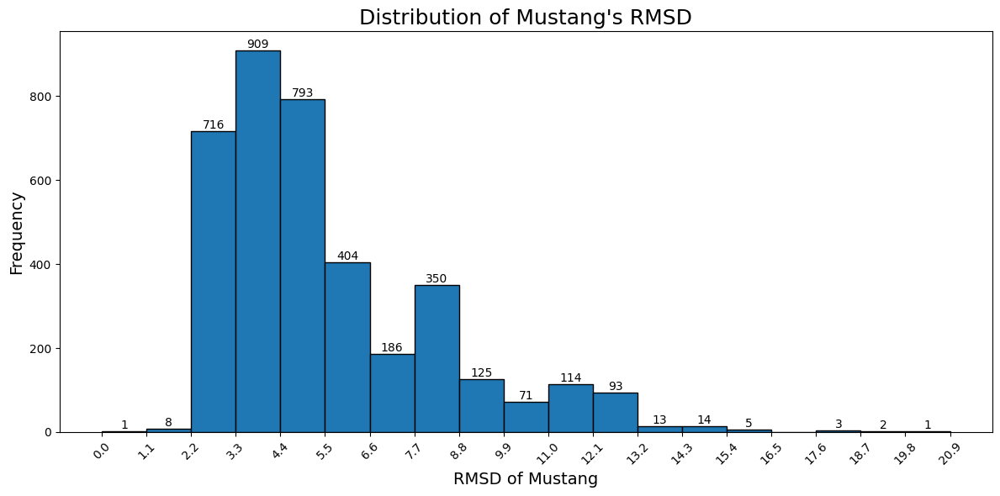

(0.0, 1.1]: 0 structures
(1.1, 2.2]: 11 structures
  - 4FG7_A
  - 4MNE_B
  - 5VAM_A
  - 6Q0J_A
  - 6Q0K_A
  - 6Q0K_B
  - 6Q0T_A
  - 6Q0T_B
  - 6XFP_A
  - 6XLO_A
  - 7K0V_B
(2.2, 3.3]: 713 structures
  - 1FGK_A
  - 1GJO_A
  - 1IG1_A
  - 1JKK_A
  - 1JKL_A
  - 1JKS_A
  - 1JKT_A
  - 1JKT_B
  - 1JOW_B
  - 1M52_A
  - 1M52_B
  - 1OEC_A
  - 1OPJ_B
  - 1OPK_A
  - 1OPL_A
  - 1OPL_B
  - 1P4F_A
  - 1PHK_A
  - 1QL6_A
  - 1QPC_A
  - 1QPD_A
  - 1QPE_A
  - 1QPJ_A
  - 1U46_B
  - 1U4D_B
  - 1U54_A
  - 1U54_B
  - 1U5Q_B
  - 1W98_A
  - 1WVW_A
  - 1WVX_A
  - 1WVY_A
  - 1XBA_A
  - 1XBB_A
  - 1XBC_A
  - 1Y57_A
  - 1YI6_A
  - 1YI6_B
  - 1YRP_A
  - 1YRP_B
  - 1YVJ_A
  - 1ZWS_A
  - 1ZWS_B
  - 1ZWS_C
  - 1ZWS_D
  - 1ZWS_E
  - 1ZWS_F
  - 1ZWS_G
  - 1ZWS_H
  - 2B7A_B
  - 2DQ7_X
  - 2F2C_B
  - 2F4J_A
  - 2FO0_A
  - 2G2F_A
  - 2G2F_B
  - 2G2H_A
  - 2G2H_B
  - 2GQG_A
  - 2GQG_B
  - 2HK5_A
  - 2HYY_C
  - 2HZ0_A
  - 2HZ4_A
  - 2HZ4_B
  - 2HZ4_C
  - 2HZI_A
  - 2HZI_B
  - 2J0L_A
  - 2OF2_A
  - 2OF4_A
  - 2OFU_A
  - 2PHK_

/tmp/ipykernel_22925/1014194093.py:35: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby("RMSD_bin")["PDB_Name"].apply(list)


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

input_file = "Results/activation_segments/nonReconstructed_filtered_mustang_withRMSD/mustang_rmsd_summary.txt"
df = pd.read_csv(input_file, sep=r"\s+", engine="python")  

# Sort all structures by RMSD (descending) and save the result
df_sorted = df.sort_values(by="RMSD", ascending=False)
df_sorted.to_csv("sorted_rmsd_mustang_summary.txt", sep="\t", index=False)

bin_width = 1.1
bins = np.arange(0, df["RMSD"].max() + bin_width, bin_width)

plt.figure(figsize=(12, 6))
n, bins_plot, patches = plt.hist(df["RMSD"], bins=bins, edgecolor='black')

# Label the top of each bar with the count
for count, x in zip(n, bins_plot[:-1]):
    if count > 0:
        plt.text(x + bin_width / 2, count, str(int(count)), ha='center', va='bottom', fontsize=10)

plt.xlabel("RMSD of Mustang", fontsize=14)
plt.ylabel("Frequency", fontsize=14)
plt.title("Distribution of Mustang's RMSD", fontsize=18)
plt.xticks(bins_plot, rotation=45, fontsize=10)
plt.tight_layout()
plt.savefig("ends_rmsd_mustang.png", dpi=300)  
plt.show()

# Group all PDBs into bins based on their RMSD value
df["RMSD_bin"] = pd.cut(df["RMSD"], bins=bins)
grouped = df.groupby("RMSD_bin")["PDB_Name"].apply(list)

for interval, pdb_list in grouped.items():
    print(f"{interval}: {len(pdb_list)} structures")
    for pdb in pdb_list:
        print(f"  - {pdb}")

output_txt = "rmsd_bins_with_pdb_names.txt"
with open(output_txt, "w") as f:
    for interval, pdb_list in grouped.items():
        f.write(f"{interval}: {len(pdb_list)} structures\n")
        for pdb in pdb_list:
            f.write(f"  - {pdb}\n")
        f.write("\n")  



Remove Outliers based on selected value

In [ ]:
import os
import shutil
import re

# Input RMSD-bin file and RMSD cutoff threshold
txt_file = "rmsd_bins_with_pdb_names.txt"
rmsd_cutoff_large = 11.0

# Define source and destination directories for PDBs
source_dir="Results/activation_segments/Mustang_with_singlechain_withoutlier"
dest_large="Results/activation_segments/Mustang_with_singlechain"

pdbs_large = set()

# Read the text file and parse PDB names that fall within acceptable RMSD bins
with open(txt_file, "r") as f:
    current_rmsd_range = None
    for line in f:
        line = line.strip()
        if line.startswith("(") and "structures" in line:
            match = re.match(r"\(([\d.]+),\s*([\d.]+)]", line)
            if match:
                low = float(match.group(1))
                high = float(match.group(2))
                current_rmsd_range = (low, high)
        elif line.startswith("-"):
            pdb_id = line[1:].strip().split(".")[0]
            if current_rmsd_range and current_rmsd_range[1] <= rmsd_cutoff_large:
                pdbs_large.add(pdb_id)

os.makedirs(dest_large, exist_ok=True)

# Copy selected PDB files from source to destination folder
for pdb_id in pdbs_large:
    src = os.path.join(source_dir, f"{pdb_id}.pdb")
    dst = os.path.join(dest_large, f"{pdb_id}.pdb")
    if os.path.exists(src):
        shutil.copy2(src, dst)

count_large = len([f for f in os.listdir(dest_large) if f.endswith(".pdb")])
print(f"✅ Copied {count_large} PDBs to {dest_large}")

all_pdb_files = [f[:-4] for f in os.listdir(source_dir) if f.endswith(".pdb")]
not_in_large = sorted(set(all_pdb_files) - pdbs_large)
print(f"\nPDBs NOT in large set (RMSD > {rmsd_cutoff_large}): {len(not_in_large)} structures")
for name in not_in_large:
    print(f" - {name}")
